In [31]:
import argparse
from pathlib import Path

import torch
import torch.nn as nn
from PIL import Image
from torchvision import transforms
from torchvision.utils import save_image

import net
from function import adaptive_instance_normalization, coral
import numpy as np
import matplotlib.pyplot as plt

In [32]:
def test_transform(size, crop):
    transform_list = []
    if size != 0:
        transform_list.append(transforms.Resize(size))
    if crop:
        transform_list.append(transforms.CenterCrop(size))
    transform_list.append(transforms.ToTensor())
    transform = transforms.Compose(transform_list)
    return transform

In [33]:
def style_transfer(vgg, decoder, content, style, alpha=1.0,
                   interpolation_weights=None):
    assert (0.0 <= alpha <= 1.0)
    content_f = vgg(content)
    style_f = vgg(style)
    if interpolation_weights:
        _, C, H, W = content_f.size()
        feat = torch.FloatTensor(1, C, H, W).zero_().to(device)
        base_feat = adaptive_instance_normalization(content_f, style_f)
        for i, w in enumerate(interpolation_weights):
            feat = feat + w * base_feat[i:i + 1]
        content_f = content_f[0:1]
    else:
        feat = adaptive_instance_normalization(content_f, style_f)
    feat = feat * alpha + content_f * (1 - alpha)
    return decoder(feat)

In [34]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
do_interpolation = False

In [35]:
output_dir = Path("output")
output_dir.mkdir(exist_ok=True, parents=True)

content_dir = Path("input/face_test/")
content_paths = [f for f in content_dir.glob('*.jpg')]

style_dir = Path("input/art_test/")
style_paths = [f for f in style_dir.glob('*.jpg')]


In [40]:
decoder = net.decoder
vgg = net.vgg

decoder.eval()
vgg.eval()

decoder.load_state_dict(torch.load("experiments/decoder_iter_20000.pth"))
vgg.load_state_dict(torch.load("models/vgg_normalised.pth"))
vgg = nn.Sequential(*list(vgg.children())[:31])

vgg.to(device)
decoder.to(device)

content_size = 512
style_size = 512
crop = True
preserve_color = True
alpha = 1.0

content_tf = test_transform(content_size, crop)
style_tf = test_transform(style_size, crop)

In [41]:
def im_convert(tensor):
    image = tensor.clone().detach().numpy().squeeze()
    image = image.transpose(1, 2, 0)        
#     image = image * 0.5  + 0.5
    image = image.clip(0, 1)
    return image

In [44]:
images = []

for style_path in style_paths:
    for content_path in content_paths:
        content = content_tf(Image.open(str(content_path)))
        style = style_tf(Image.open(str(style_path)))
        if preserve_color:
            origin_style = style
            style = coral(style, content)
        style = style.to(device).unsqueeze(0)
        content = content.to(device).unsqueeze(0)
        with torch.no_grad():
            output = style_transfer(vgg, decoder, content, style, alpha)
        content = im_convert(content.cpu().squeeze())
        origin_style = im_convert(origin_style.cpu().squeeze())
        output = im_convert(output.cpu().squeeze())
        images.append((content, origin_style, output))


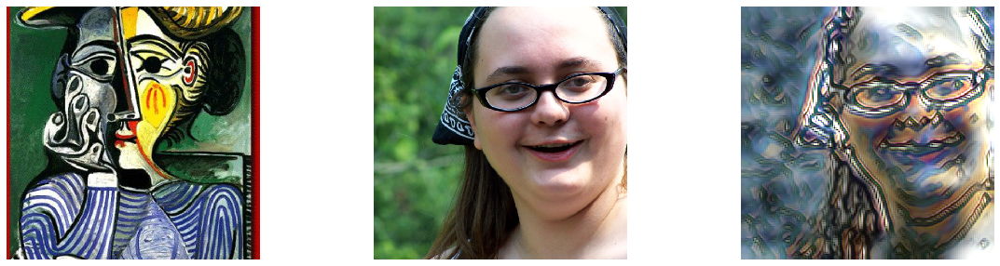

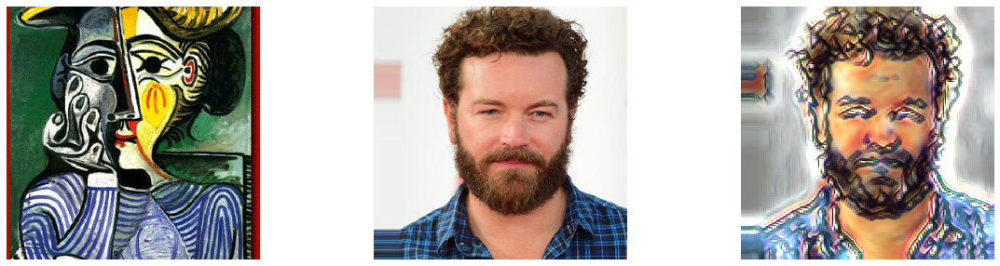

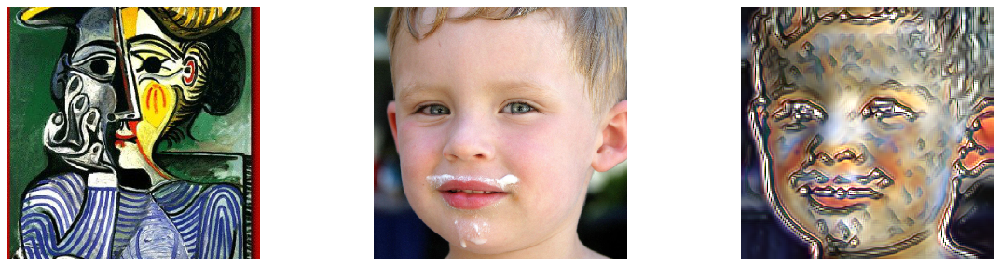

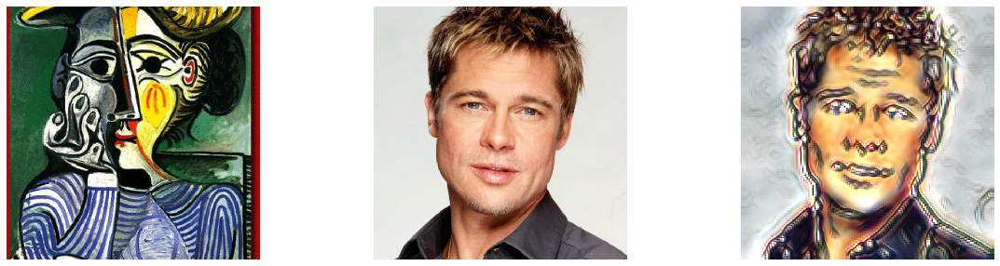

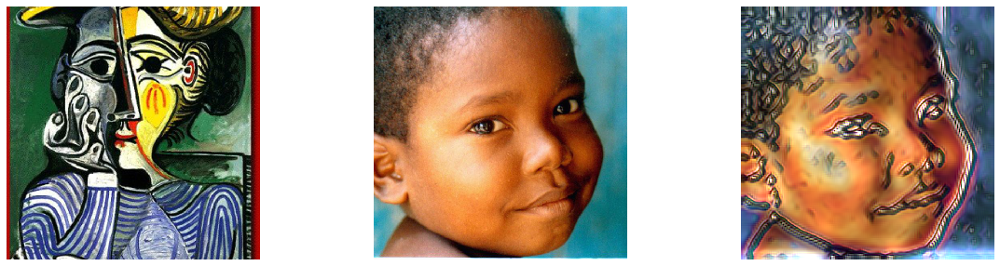

...

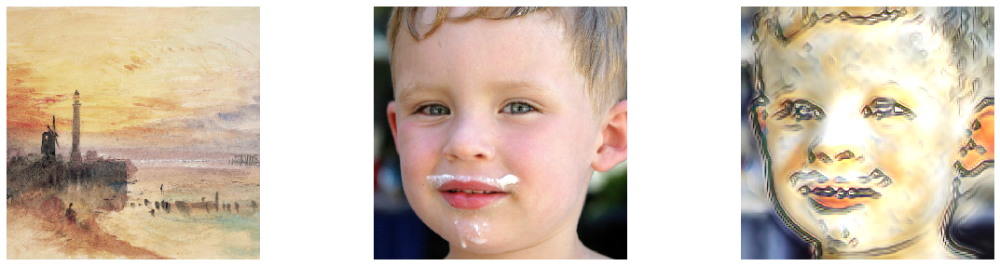

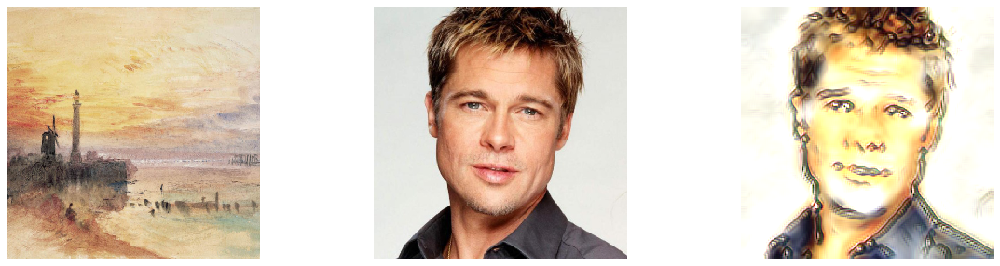

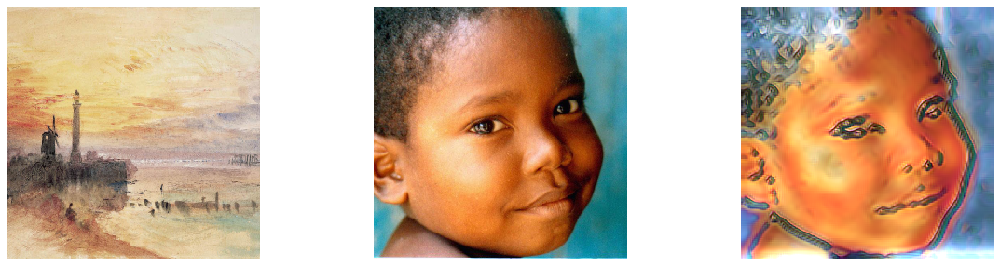

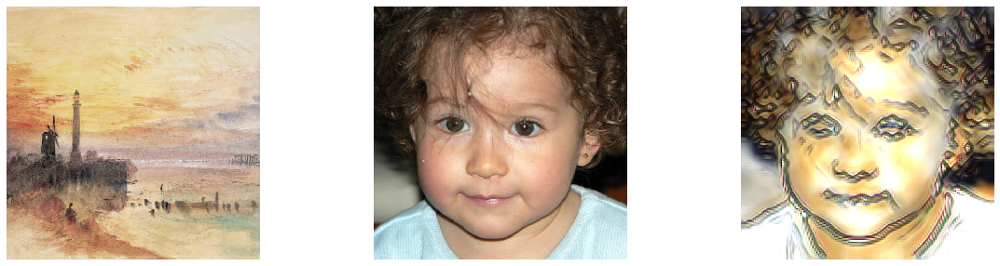

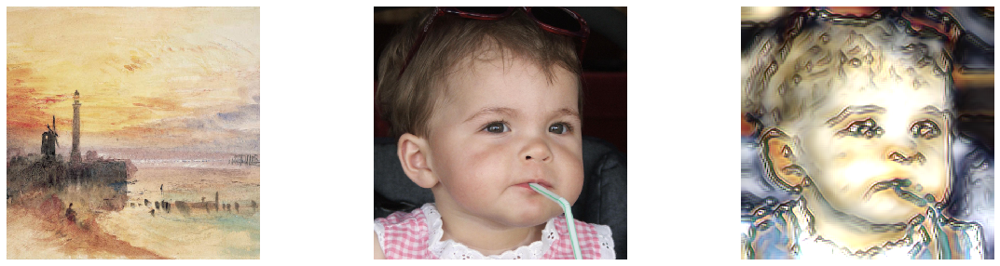

In [45]:
for content, style, output in images:
    fig, ax = plt.subplots(1, 3, figsize=(20, 5))
    ax[0].imshow(style)
    ax[0].axis('off')
    ax[1].imshow(content)
    ax[1].axis('off')
    ax[2].imshow(output)
    ax[2].axis('off')
    plt.show()